In [ ]:
# 3-1-correlation-map.ipynb was modified on 4-2-2024

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
from scipy.stats import shapiro, normaltest
import matplotlib.pyplot as plt

In [2]:
#%%capture
### data read in ###
df = pd.read_csv("2-4-outliersbye-lh_aparc.csv")
print("df.columns: {}, .format(df.columns)") 
print(df.head())

df.columns: {}, .format(df.columns)
   Study_ID   Age   Edu             NPT_date  FAS_total_raw  FAS_total_T  \
0  880e4a2d  89.0  15.0  2018-07-25 00:00:00           22.0         35.0   
1  84dd85aa  69.0  16.0  2018-03-26 00:00:00           31.0         41.0   
2  84dd85aa  69.0  16.0  2018-03-26 00:00:00           31.0         41.0   
3  84dd85aa  69.0  16.0  2018-03-26 00:00:00           31.0         41.0   
4  84dd85aa  69.0  16.0  2018-03-26 00:00:00           31.0         41.0   

   Animals_raw  Animals_T  BNT_totalwstim_raw  BNT_totalwstim_T  ...  \
0         15.0       46.0                39.0              35.0  ...   
1         16.0       42.0                59.0              65.0  ...   
2         16.0       42.0                59.0              65.0  ...   
3         16.0       42.0                59.0              65.0  ...   
4         16.0       42.0                59.0              65.0  ...   

   rostralmiddlefrontal  superiorfrontal  superiorparietal  superiortempor

In [3]:
#%%capture
### replace missing data with NaN
df_empty2NaN = df.astype('object')
missing_value_count = df_empty2NaN.isna().sum()
print(f"missing value counts\n{missing_value_count}")
pd.set_option('display.max_rows', None)

#print(df_empty2NaN['Handedness'])

### already removed the left handed participants' dataset in 2-4-outliersbye_lh_aparc.ipynb
### Remove rows where 'Handedness' == '2' (left handed) and 'Handedness' == NaN
lefties_removed = df_empty2None[df_empty2None['Handedness'] == 2].shape[0]
df_right = df_empty2None[df_empty2None['Handedness'] != 2].dropna(subset = ['Handedness'])
print(f'{lefties_removed} were left_handed, {missing_value_count[-1]} were missing')
print("df.columns : {}".format(df.columns))


missing value counts
Study_ID                     0
Age                          1
Edu                          7
NPT_date                     1
FAS_total_raw               48
FAS_total_T                 54
Animals_raw                 50
Animals_T                   57
BNT_totalwstim_raw          48
BNT_totalwstim_T            54
bankssts                     0
caudalanteriorcingulate      0
caudalmiddlefrontal          0
cuneus                       0
entorhinal                   0
fusiform                     0
inferiorparietal             0
inferiortemporal             0
isthmuscingulate             0
lateraloccipital             0
lateralorbitofrontal         0
lingual                      0
medialorbitofrontal          0
middletemporal               0
parahippocampal              0
paracentral                  0
parsopercularis              0
parsorbitalis                0
parstriangularis             0
pericalcarine                0
postcentral                  0
posteriorcingulate

NameError: name 'df_empty2None' is not defined

In [4]:
print("columns \n{}".format(df.columns))
df.columns.shape[0]

columns 
Index(['Study_ID', 'Age', 'Edu', 'NPT_date', 'FAS_total_raw', 'FAS_total_T',
       'Animals_raw', 'Animals_T', 'BNT_totalwstim_raw', 'BNT_totalwstim_T',
       'bankssts', 'caudalanteriorcingulate', 'caudalmiddlefrontal', 'cuneus',
       'entorhinal', 'fusiform', 'inferiorparietal', 'inferiortemporal',
       'isthmuscingulate', 'lateraloccipital', 'lateralorbitofrontal',
       'lingual', 'medialorbitofrontal', 'middletemporal', 'parahippocampal',
       'paracentral', 'parsopercularis', 'parsorbitalis', 'parstriangularis',
       'pericalcarine', 'postcentral', 'posteriorcingulate', 'precentral',
       'precuneus', 'rostralanteriorcingulate', 'rostralmiddlefrontal',
       'superiorfrontal', 'superiorparietal', 'superiortemporal',
       'supramarginal', 'frontalpole', 'temporalpole', 'transversetemporal',
       'insula', 'Handedness'],
      dtype='object')


45

Age 1/45
Age normality test: statistic = nan, p-value = nan
Age normality test: statistic = nan, p-value = nan
Edu 2/45
Edu normality test: statistic = nan, p-value = nan
Edu normality test: statistic = nan, p-value = nan
FAS_total_raw 3/45
FAS_total_raw normality test: statistic = nan, p-value = nan
FAS_total_raw normality test: statistic = nan, p-value = nan
FAS_total_T 4/45
FAS_total_T normality test: statistic = nan, p-value = nan
FAS_total_T normality test: statistic = nan, p-value = nan


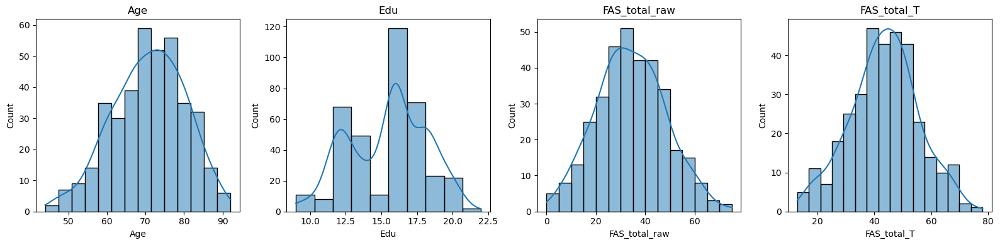

Animals_raw 5/45
Animals_raw normality test: statistic = nan, p-value = nan
Animals_raw normality test: statistic = nan, p-value = nan
Animals_T 6/45
Animals_T normality test: statistic = nan, p-value = nan
Animals_T normality test: statistic = nan, p-value = nan
BNT_totalwstim_raw 7/45
BNT_totalwstim_raw normality test: statistic = nan, p-value = nan
BNT_totalwstim_raw normality test: statistic = nan, p-value = nan
BNT_totalwstim_T 8/45
BNT_totalwstim_T normality test: statistic = nan, p-value = nan
BNT_totalwstim_T normality test: statistic = nan, p-value = nan


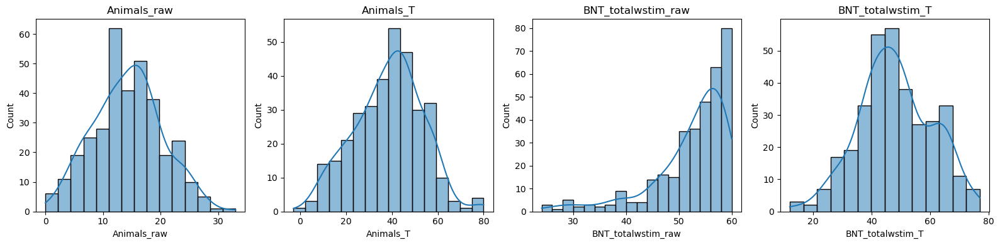

bankssts 9/45
bankssts normality test: statistic = 7.3230, p-value = 0.0257
bankssts normality test: statistic = 7.3230, p-value = 0.0257
caudalanteriorcingulate 10/45
caudalanteriorcingulate normality test: statistic = 3.6266, p-value = 0.1631
caudalanteriorcingulate normality test: statistic = 3.6266, p-value = 0.1631
caudalmiddlefrontal 11/45
caudalmiddlefrontal normality test: statistic = 1.8376, p-value = 0.3990
caudalmiddlefrontal normality test: statistic = 1.8376, p-value = 0.3990
cuneus 12/45
cuneus normality test: statistic = 21.4875, p-value = 0.0000
cuneus normality test: statistic = 21.4875, p-value = 0.0000


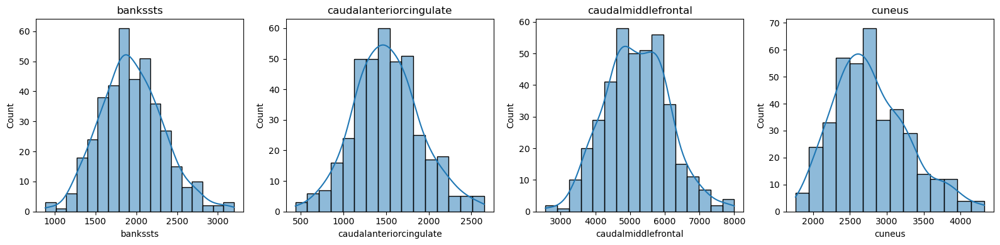

entorhinal 13/45
entorhinal normality test: statistic = 0.6741, p-value = 0.7139
entorhinal normality test: statistic = 0.6741, p-value = 0.7139
fusiform 14/45
fusiform normality test: statistic = 0.9102, p-value = 0.6344
fusiform normality test: statistic = 0.9102, p-value = 0.6344
inferiorparietal 15/45
inferiorparietal normality test: statistic = 0.0357, p-value = 0.9823
inferiorparietal normality test: statistic = 0.0357, p-value = 0.9823
inferiortemporal 16/45
inferiortemporal normality test: statistic = 7.7810, p-value = 0.0204
inferiortemporal normality test: statistic = 7.7810, p-value = 0.0204


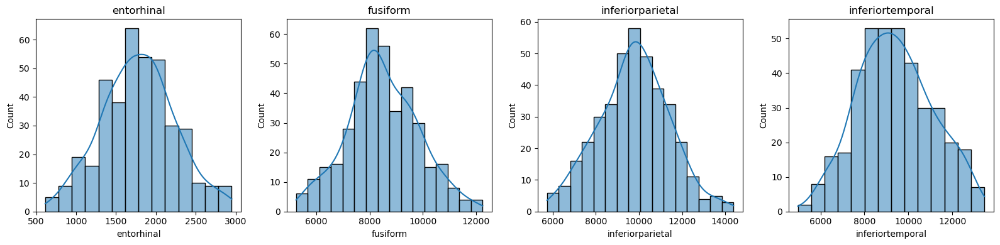

isthmuscingulate 17/45
isthmuscingulate normality test: statistic = 5.8973, p-value = 0.0524
isthmuscingulate normality test: statistic = 5.8973, p-value = 0.0524
lateraloccipital 18/45
lateraloccipital normality test: statistic = 1.2251, p-value = 0.5420
lateraloccipital normality test: statistic = 1.2251, p-value = 0.5420
lateralorbitofrontal 19/45
lateralorbitofrontal normality test: statistic = 0.3049, p-value = 0.8586
lateralorbitofrontal normality test: statistic = 0.3049, p-value = 0.8586
lingual 20/45
lingual normality test: statistic = 6.2083, p-value = 0.0449
lingual normality test: statistic = 6.2083, p-value = 0.0449


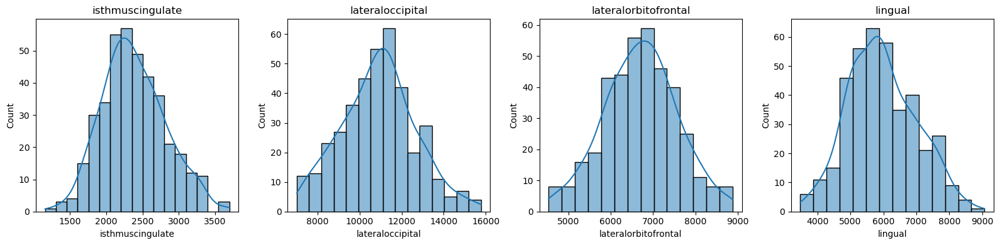

medialorbitofrontal 21/45
medialorbitofrontal normality test: statistic = 0.6888, p-value = 0.7086
medialorbitofrontal normality test: statistic = 0.6888, p-value = 0.7086
middletemporal 22/45
middletemporal normality test: statistic = 4.7264, p-value = 0.0941
middletemporal normality test: statistic = 4.7264, p-value = 0.0941
parahippocampal 23/45
parahippocampal normality test: statistic = 0.7960, p-value = 0.6716
parahippocampal normality test: statistic = 0.7960, p-value = 0.6716
paracentral 24/45
paracentral normality test: statistic = 1.3034, p-value = 0.5212
paracentral normality test: statistic = 1.3034, p-value = 0.5212


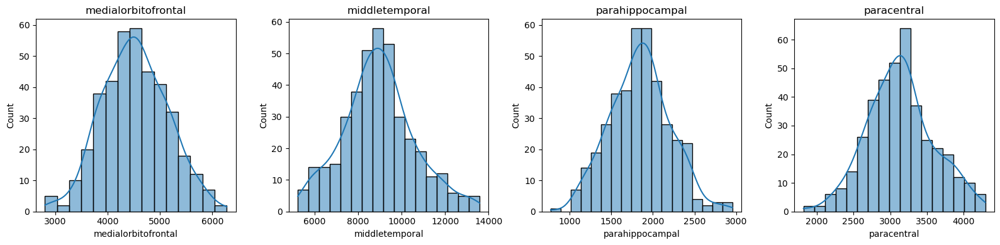

parsopercularis 25/45
parsopercularis normality test: statistic = 5.9838, p-value = 0.0502
parsopercularis normality test: statistic = 5.9838, p-value = 0.0502
parsorbitalis 26/45
parsorbitalis normality test: statistic = 9.0572, p-value = 0.0108
parsorbitalis normality test: statistic = 9.0572, p-value = 0.0108
parstriangularis 27/45
parstriangularis normality test: statistic = 12.1515, p-value = 0.0023
parstriangularis normality test: statistic = 12.1515, p-value = 0.0023
pericalcarine 28/45
pericalcarine normality test: statistic = 10.5411, p-value = 0.0051
pericalcarine normality test: statistic = 10.5411, p-value = 0.0051


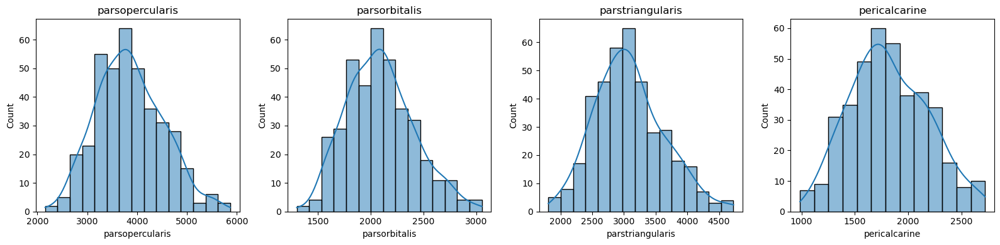

postcentral 29/45
postcentral normality test: statistic = 1.3919, p-value = 0.4986
postcentral normality test: statistic = 1.3919, p-value = 0.4986
posteriorcingulate 30/45
posteriorcingulate normality test: statistic = 3.2381, p-value = 0.1981
posteriorcingulate normality test: statistic = 3.2381, p-value = 0.1981
precentral 31/45
precentral normality test: statistic = 1.7046, p-value = 0.4264
precentral normality test: statistic = 1.7046, p-value = 0.4264
precuneus 32/45
precuneus normality test: statistic = 2.5519, p-value = 0.2792
precuneus normality test: statistic = 2.5519, p-value = 0.2792


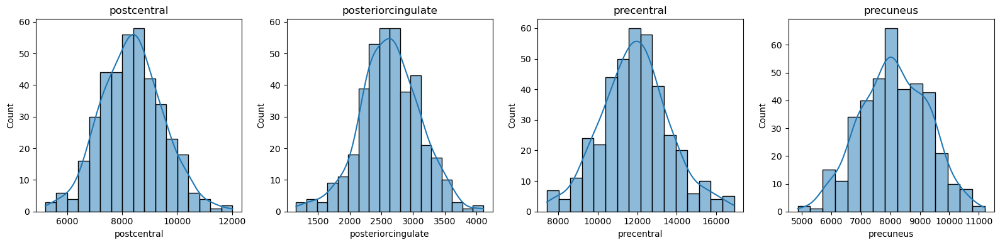

rostralanteriorcingulate 33/45
rostralanteriorcingulate normality test: statistic = 1.8782, p-value = 0.3910
rostralanteriorcingulate normality test: statistic = 1.8782, p-value = 0.3910
rostralmiddlefrontal 34/45
rostralmiddlefrontal normality test: statistic = 1.6959, p-value = 0.4283
rostralmiddlefrontal normality test: statistic = 1.6959, p-value = 0.4283
superiorfrontal 35/45
superiorfrontal normality test: statistic = 4.3084, p-value = 0.1160
superiorfrontal normality test: statistic = 4.3084, p-value = 0.1160
superiorparietal 36/45
superiorparietal normality test: statistic = 1.0062, p-value = 0.6047
superiorparietal normality test: statistic = 1.0062, p-value = 0.6047


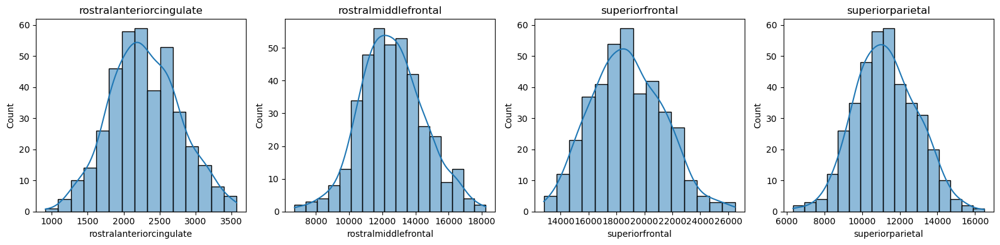

superiortemporal 37/45
superiortemporal normality test: statistic = 5.4336, p-value = 0.0661
superiortemporal normality test: statistic = 5.4336, p-value = 0.0661
supramarginal 38/45
supramarginal normality test: statistic = 11.1191, p-value = 0.0039
supramarginal normality test: statistic = 11.1191, p-value = 0.0039
frontalpole 39/45
frontalpole normality test: statistic = 2.5600, p-value = 0.2780
frontalpole normality test: statistic = 2.5600, p-value = 0.2780
temporalpole 40/45
temporalpole normality test: statistic = 5.3361, p-value = 0.0694
temporalpole normality test: statistic = 5.3361, p-value = 0.0694


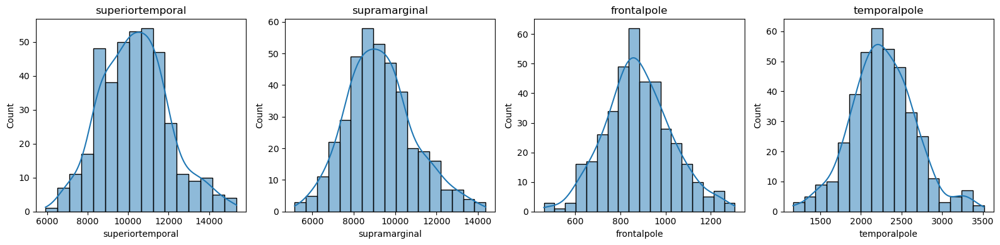

transversetemporal 41/45
transversetemporal normality test: statistic = 12.2809, p-value = 0.0022
transversetemporal normality test: statistic = 12.2809, p-value = 0.0022
insula 42/45
insula normality test: statistic = 1.3909, p-value = 0.4989
insula normality test: statistic = 1.3909, p-value = 0.4989
Handedness 43/45
Handedness normality test: statistic = nan, p-value = nan
Handedness normality test: statistic = nan, p-value = nan


/usr/local/anaconda3/lib/python3.11/site-packages/scipy/stats/_morestats.py:1879: UserWarning: Input data for shapiro has range zero. The results may not be accurate.
  warnings.warn("Input data for shapiro has range zero. The results "
/usr/local/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:1606: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  b2 = skew(a, axis)
/usr/local/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:1808: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  b2 = kurtosis(a, axis, fisher=False)


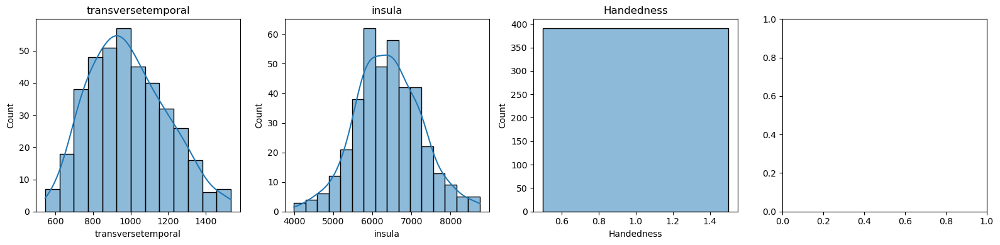

In [5]:
# 5 - Assumption check
# Define the number of columns in the grid
num_cols = 4

# Initialize variables to collect histograms
histograms = []

variable_count = 1

# Initialize the subplot index
subplot_index = 0

# Create the first set of subplots
fig,axes = plt.subplots(1, num_cols, figsize=(16,4))

# Iterate through each column
for column in df.columns:
    if column not in ["Study_ID","NPT_date"]:
        print("{} {}/{}".format(column,variable_count,(df.columns.shape[0])))
        
        # Perform normality tests
        stat, p = shapiro(df[column])
        stat, p = normaltest(df[column])
        print(f'{column} normality test: statistic = {stat:.4f}, p-value = {p:.4f}') # p-value > 0.05: normal
        print(f'{column} normality test: statistic = {stat:.4f}, p-value = {p:.4f}') # The D'Agostino and Pearson's test - measure of skewness and kurtosis
        variable_count += 1

        # Plot histogram on the current subplot
        sns.histplot(df[column], kde =True, ax = axes[subplot_index])
        axes[subplot_index].set_title(column)
        histograms.append(column)
        
        # Increment the subplot index
        subplot_index += 1
        
        # Check if we need to create a new row of subplots 
        if subplot_index == num_cols:
          plt.tight_layout()
          plt.show()
          fig, axes = plt.subplots(1, num_cols, figsize = (16,4))
          subplot_index = 0
# Check if any remaining histograms need to be displayed
if subplot_index > 0:
    plt.tight_layout()
    plt.show()
        
    



       
    ###check for linearity    
#     plt.scatter(x = 'parahippocampal', y = 'FAS_total_raw', data=df)
#     plt.show()
    

In [6]:
#6 - Check linearities
# Drop any non_numeric columns from the DataFrame if necessary
numeric_df = df.select_dtypes(include='number')

# Create a pairplot
sns.pairplot(numeric_df)
plt.show()

/usr/local/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


In [7]:
#7 - Corr matrix
correlation_matrix = df.corr()

#plot the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot = True, cmap = 'coolwarm', fmt ="2f")
plt.title("correlation matrix")
plt.show()

ValueError: could not convert string to float: '880e4a2d'